In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import sklearn

import librosa
import librosa.display
import IPython.display as ipd
import warnings
warnings.filterwarnings('ignore')
import os

opj = os.path.join

In [4]:
gtzan_path = r'datasets\gtzan'
genres_dir = opj(gtzan_path, 'genres_original')

First, let's learn how to calculate length of the audio track in seconds. There is this phenomenon called sample rate, which tells, how many times per second a track is recorded. As sound is a continous phenomenon, we cannot infinitile quickly record it - we measure recording in sampling rate. So for example for sample rate of 100 Hz (1Hz is one action per second) we sample an audio 100 times per second.

In [5]:
y, sr = librosa.load(opj(genres_dir, 'jazz', 'jazz.00001.wav'))

print('y:', y, '\n')
print('y shape:', y.shape, '\n')
print('Sample rate (kHz):', sr, '\n')

print('Audio length: ', y.shape[0] / sr)

y: [0.00241089 0.00549316 0.00866699 ... 0.00201416 0.00250244 0.00119019] 

y shape: (661794,) 

Sample rate (kHz): 22050 

Audio length:  30.013333333333332


Our .wav file contains useful information, such as sampling rate. We see that the track has 30 seconds and was sampled 22 050 000 times per second! We found it out by dividing a total number of sound samples by how many samples we take per second. Easy, right?

In [6]:
#Trim silence at the beginning and at the end of the track
audio_file, _ = librosa.effects.trim(y)

print('Audio File: ', audio_file, '\n')
print('Audo File shape:', np.shape(audio_file))

print('Real sound lasts: ', audio_file.shape[0] / sr)


Audio File:  [0.00241089 0.00549316 0.00866699 ... 0.00201416 0.00250244 0.00119019] 

Audo File shape: (661794,)
Real sound lasts:  30.013333333333332


Actually, our music starts right away, and ends when still running!

Here we can see a waveplot of each second in an audio. As for the jazz music, we can see different characteristics of the song at specific intervals

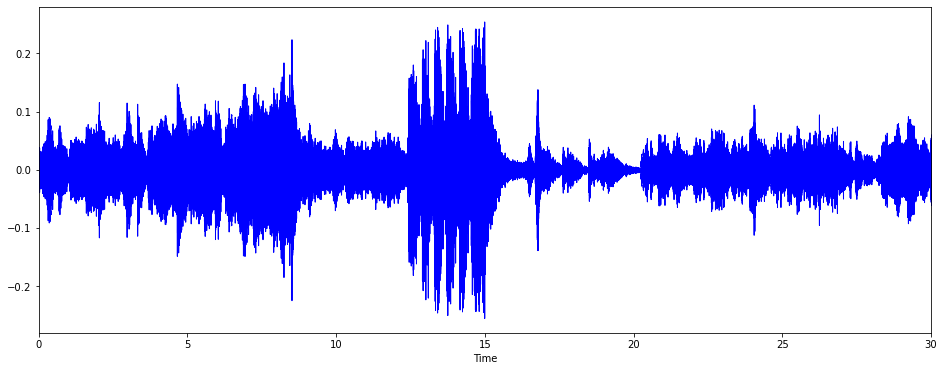

In [5]:
plt.figure(figsize=(16, 6))
librosa.display.waveplot(y=audio_file, sr = sr, color="blue")

For comparison, let's see what would be an audio wave of an examplary hiphop audio

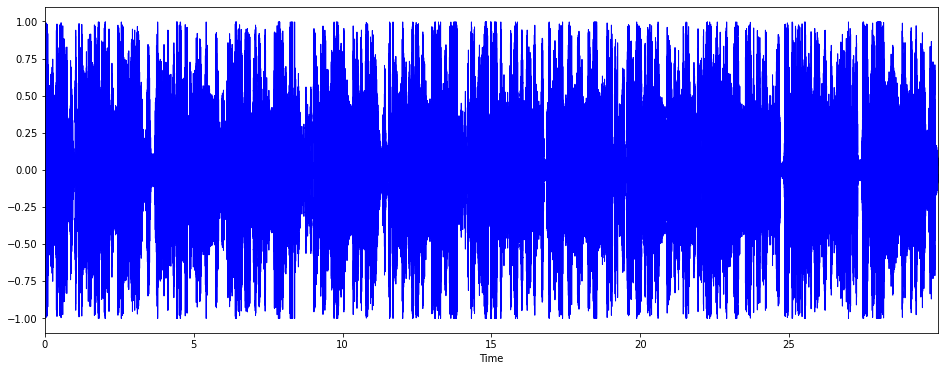

In [9]:
hiphop_audio, hiphop_sr = librosa.load(opj(genres_dir, 'hiphop', 'hiphop.00001.wav'))
plt.figure(figsize=(16, 6))
librosa.display.waveplot(y=hiphop_audio, sr = hiphop_sr, color="blue")

The difference between hiphop audio and jazz audio is clearly visible

In [10]:
audio_file.shape

(661794,)

We can generate Short Fast Fourier transform for an audio file. We divide an audio by hop_length, which is sort of a sliding windows over an audio. In a specific frame, a Fast Fourier Transform is calculated and an amplitude spectrogram is created. For a hop_length of 512, we will generate about 1293 time-frequency plots (for each 512 non-overlapping hop), by taking an interval of 2048 samples for FFT window size(we hop by 512 frames, but compared to previous section, we have 3/4 of the same audio segment)

In [12]:

n_fft = 2048 # FFT windows size
hop_length = 512 # number of audio frames between STFT columns

D = np.abs(librosa.stft(audio_file, n_fft, hop_length=hop_length))

print('Shape of D object:', np.shape(D))

Shape of D object: (1025, 1293)


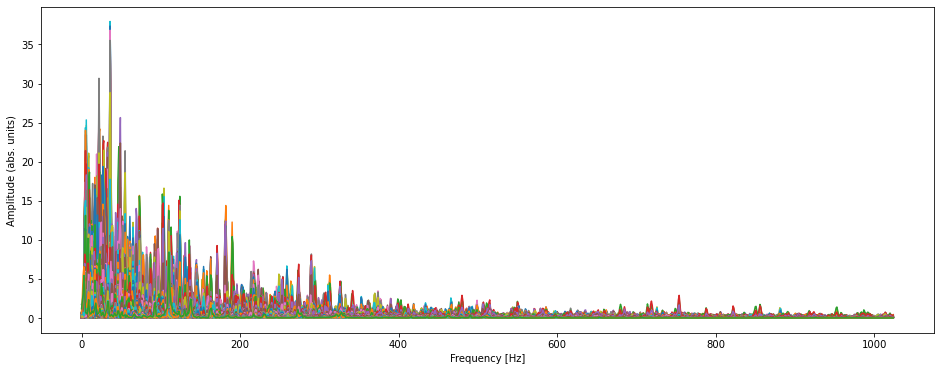

In [13]:
plt.figure(figsize=(16, 6))
plt.plot(D)
plt.xlabel('Frequency [Hz]')
plt.ylabel('Amplitude (abs. units)')
plt.show()

We can transform it to a more descriptive form, a dB-scaled spectrogram. It shows, what is an intensity of a given frequency at given second in an audio file. We could even try and apply CNN on these plots to discover if we can classify music genres based on these plots!

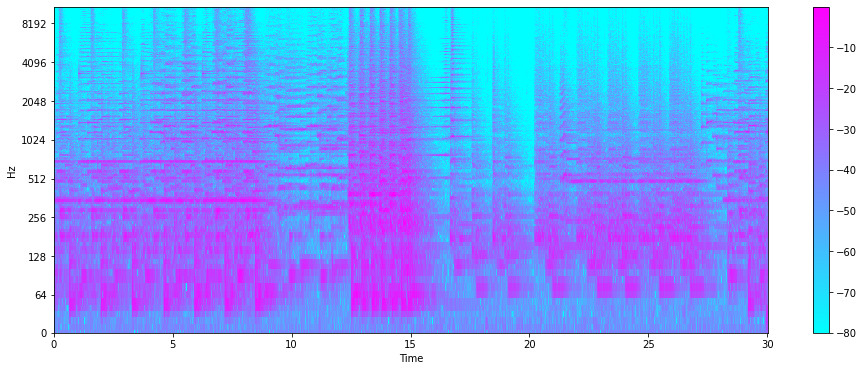

In [8]:
DB = librosa.amplitude_to_db(D, ref=np.max)

plt.figure(figsize=(16, 6))
librosa.display.specshow(DB, sr=sr, hop_length=hop_length, x_axis='time', y_axis='log', cmap='cool')
plt.colorbar()
plt.show()

The number of times a signal crosses a horizontal axis

In [14]:
zero_crossings = librosa.zero_crossings(audio_file, pad=False)
print(sum(zero_crossings))

39308


Harmonic percusive source separation. We can think of it as separation of instruments like piano or guitar from drums

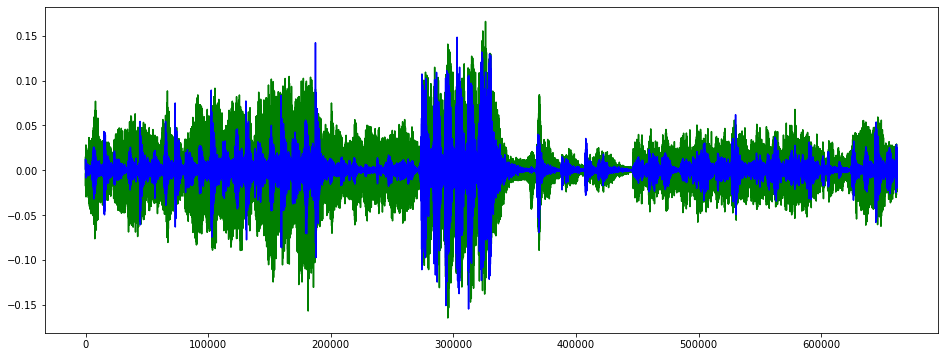

In [15]:
y_harm, y_perc = librosa.effects.hpss(audio_file)

plt.figure(figsize=(16, 6))
plt.plot(y_harm, color='green')
plt.plot(y_perc, color='blue')

Tempo BMP (beats per minute). Indicates if the music is calm or quite jumpy

In [16]:
tempo, _ = librosa.beat.beat_track(y, sr=sr)
tempo

135.99917763157896

Spectral centroid is a measure used in digital signal processing to characterise a spectrum. It indicates where the center of mass of the spectrum is located. Perceptually, it has a robust connection with the impression of brightness of a sound.

In [18]:
spectral_centroids = librosa.feature.spectral_centroid(audio_file, sr=sr)[0]

print('Centroids: ', spectral_centroids, '\n')
print('Shape of Spectral Centroids: ', spectral_centroids.shape, '\n')

frames = range(len(spectral_centroids))

t = librosa.frames_to_time(frames)

print('frames: ', frames, '\n')
print('t: ', t)

# Function that normalizes the Sound Data
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

Centroids:  [ 631.93398167  610.56918524  627.57124378 ... 1244.92381236 1287.7815212
 1537.09366986] 

Shape of Spectral Centroids:  (1293,) 

frames:  range(0, 1293) 

t:  [0.00000000e+00 2.32199546e-02 4.64399093e-02 ... 2.99537415e+01
 2.99769615e+01 3.00001814e+01]


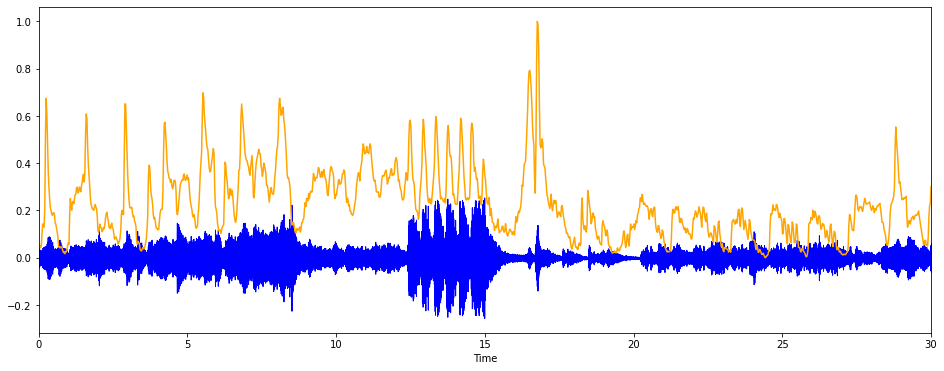

In [20]:
# Plotting the Spectral Centroid along the waveform
plt.figure(figsize=(16, 6))
librosa.display.waveplot(audio_file, sr=sr, color="blue")
plt.plot(t, normalize(spectral_centroids), color='orange')

Chroma frequencies

Let's see what are the intensities of different pitches in an audio file

Chromogram shape:  (12, 133)


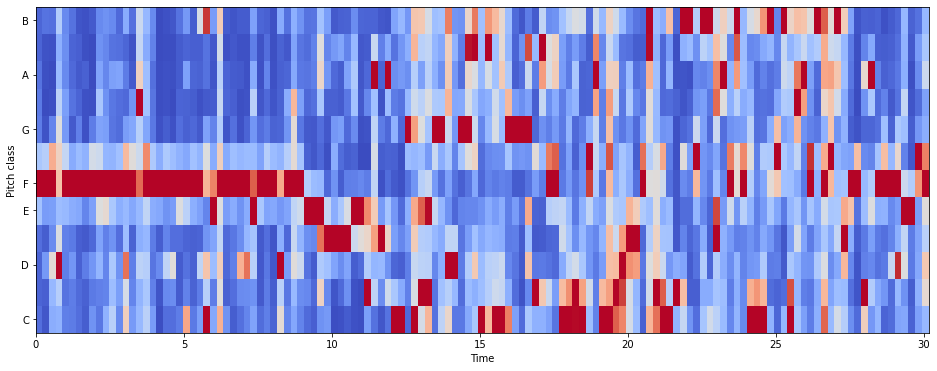

In [21]:
hop_length = 5000

# Chromogram 
chromogram = librosa.feature.chroma_stft(audio_file, sr=sr, hop_length=hop_length)
print('Chromogram shape: ', chromogram.shape)

plt.figure(figsize=(16, 6))
librosa.display.specshow(chromogram, x_axis='time', y_axis='chroma', hop_length=hop_length, cmap='coolwarm')
plt.show()

Okay, let us now play a little bit without csv data, which has different features for each audio file in our dataset

In [23]:
data = pd.read_csv(opj(gtzan_path, 'features_30_sec.csv'))
data.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.wav,661794,0.350088,0.088757,0.130228,0.002827,1784.165850,129774.064525,2002.449060,85882.761315,...,52.420910,-1.690215,36.524071,-0.408979,41.597103,-2.303523,55.062923,1.221291,46.936035,blues
1,blues.00001.wav,661794,0.340914,0.094980,0.095948,0.002373,1530.176679,375850.073649,2039.036516,213843.755497,...,55.356403,-0.731125,60.314529,0.295073,48.120598,-0.283518,51.106190,0.531217,45.786282,blues
2,blues.00002.wav,661794,0.363637,0.085275,0.175570,0.002746,1552.811865,156467.643368,1747.702312,76254.192257,...,40.598766,-7.729093,47.639427,-1.816407,52.382141,-3.439720,46.639660,-2.231258,30.573025,blues
3,blues.00003.wav,661794,0.404785,0.093999,0.141093,0.006346,1070.106615,184355.942417,1596.412872,166441.494769,...,44.427753,-3.319597,50.206673,0.636965,37.319130,-0.619121,37.259739,-3.407448,31.949339,blues
4,blues.00004.wav,661794,0.308526,0.087841,0.091529,0.002303,1835.004266,343399.939274,1748.172116,88445.209036,...,86.099236,-5.454034,75.269707,-0.916874,53.613918,-4.404827,62.910812,-11.703234,55.195160,blues


Lets see correlations between mean features in our data

In [24]:
mean_cols = [column for column in data.columns if 'mean' in column]
corr_matrix = data[mean_cols].corr()

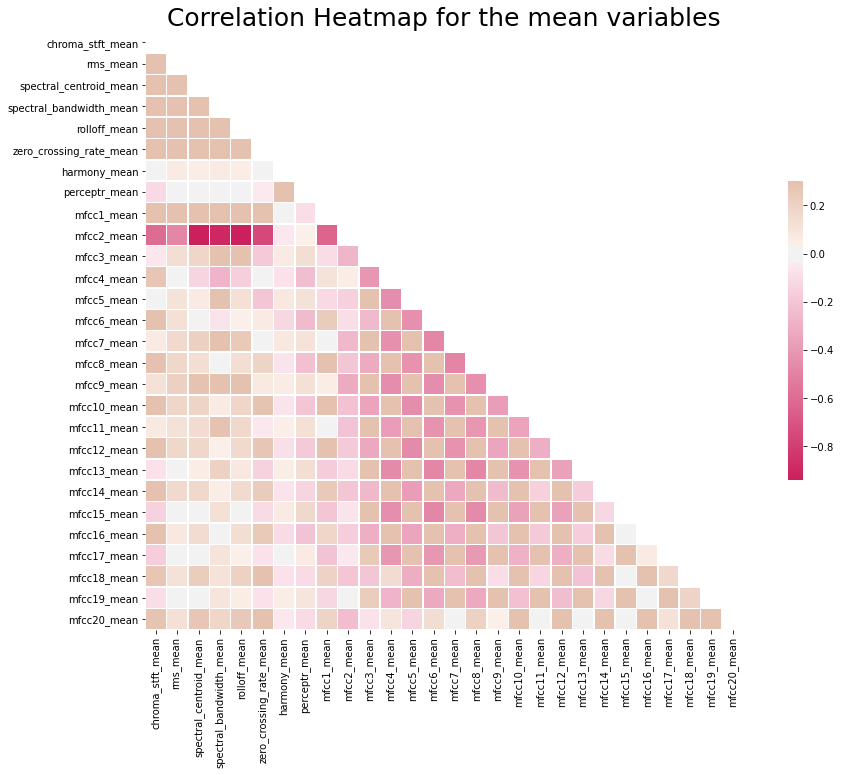

In [25]:
mask = np.triu(np.ones_like(corr_matrix, dtype=np.bool))
fig, ax = plt.subplots(figsize=(16, 11))

cmap = sns.diverging_palette(0, 25, as_cmap=True, s=90, l=45, n=5)

sns.heatmap(corr_matrix, mask=mask, cmap=cmap, vmax=.3, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.title('Correlation Heatmap for the mean variables', fontsize=25)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

plt.savefig("corr_heatmap.jpg")

Boxplots for tempos across different music types. We may observe that disco music is quite monotonous in its tempo!

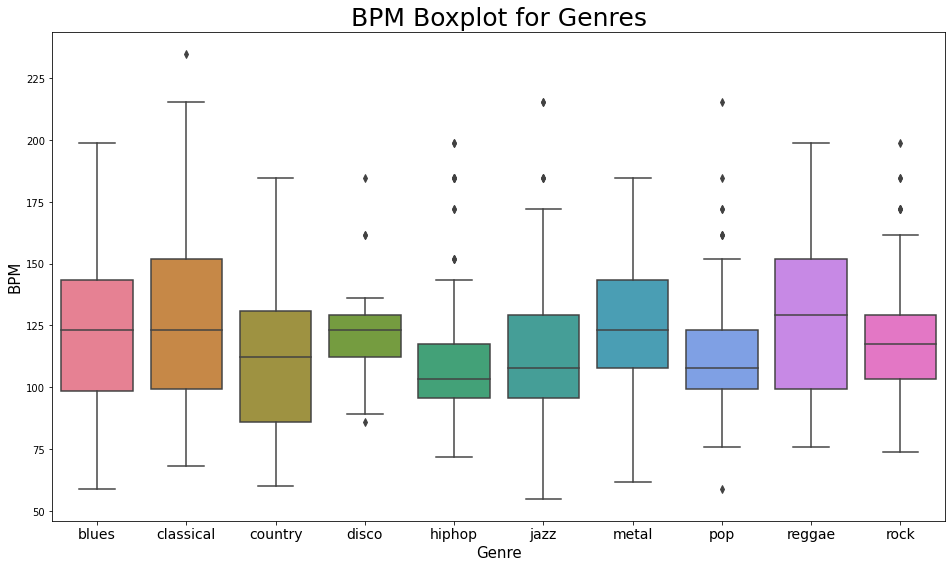

In [26]:
x = data[["label", "tempo"]]

fig, ax = plt.subplots(figsize=(16, 9))
sns.boxplot(x='label', y='tempo', data=x, palette='husl')

plt.title('BPM Boxplot for Genres', fontsize=25)
plt.xticks(fontsize=14)
plt.yticks(fontsize=10)
plt.xlabel("Genre", fontsize=15)
plt.ylabel("BPM", fontsize = 15)
plt.ylabel("BPM", fontsize=15)
plt.savefig("tempo_boxplot.jpg")

Some outliers can be clearly distinguished in different music types

Lets perform feature extraction from the data using PCA. First we need to normalize the data to the same range of values for each feature. Next, we will use PCa from sklearn to create 2D plot of 2 principal components

In [31]:
from sklearn import preprocessing

data = data.iloc[0:, 1:]
y = data['label']
X = data.loc[:, data.columns != 'label']

cols = X.columns
min_max_scaler = preprocessing.MinMaxScaler()
np_scaled = min_max_scaler.fit_transform(X)
X = pd.DataFrame(np_scaled, columns = cols)


from sklearn.decomposition import PCA

pca = PCA(n_components=2)
principalComponents = pca.fit_transform(X)
principalDf = pd.DataFrame(data = principalComponents, columns = ['principal component 1', 'principal component 2'])

# concatenate with target label
finalDf = pd.concat([principalDf, y], axis = 1)

pca.explained_variance_ratio_

array([0.25853787, 0.20507094])

We have only about 46 % of explained variance from the data. It's not too much information from just 2 principal components. Let's plot these components on 2D plot

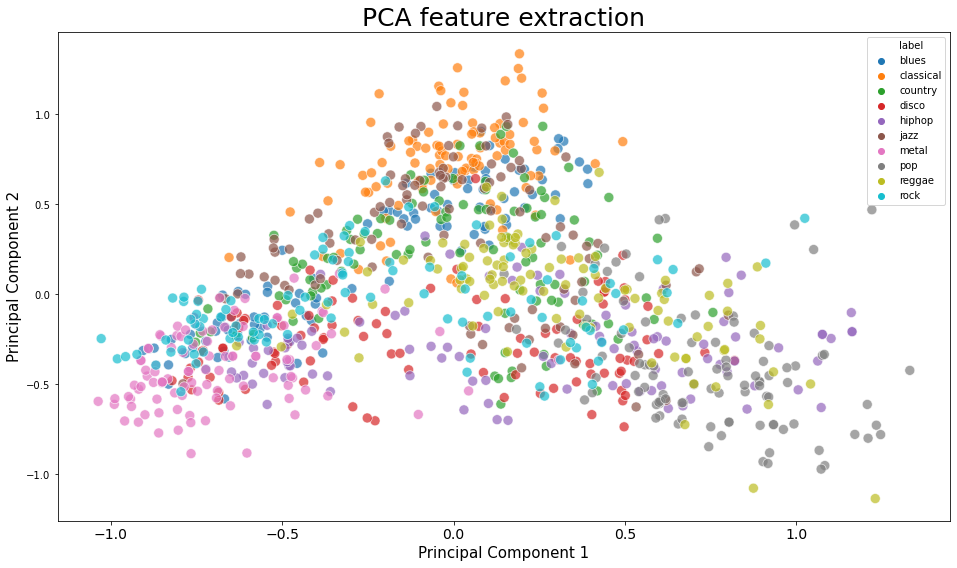

In [32]:
plt.figure(figsize = (16, 9))
sns.scatterplot(x = "principal component 1", y = "principal component 2", data = finalDf, hue = "label", alpha = 0.7,
               s = 100);

plt.title('PCA feature extraction', fontsize = 25)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 10);
plt.xlabel("Principal Component 1", fontsize = 15)
plt.ylabel("Principal Component 2", fontsize = 15)
plt.savefig("pca_2_components.jpg")

we can also use UMAP to check if we are able to cluster different types together in unsupervised manner. Let's do that!

In [43]:
import umap
from sklearn.preprocessing import StandardScaler
reducer = umap.UMAP(n_components=2)

# let's perform standard scaling, so center the data around 0 and divide to unit variance
scaler = StandardScaler()
data_scaled = scaler.fit_transform(np_scaled)
data_umap = reducer.fit_transform(data_scaled)

X_umap = pd.DataFrame(data_umap, columns = ['UMAP component 1', 'UMAP component 2'])


# concatenate with target label
finalDf = pd.concat([X_umap, y], axis = 1)



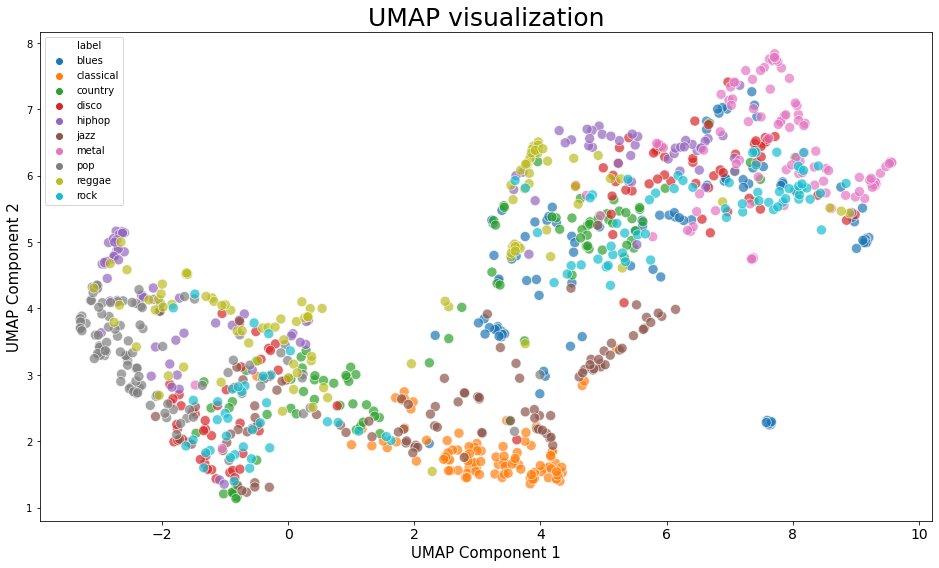

In [44]:
plt.figure(figsize = (16, 9))
sns.scatterplot(x = "UMAP component 1", y = "UMAP component 2", data = finalDf, hue = "label", alpha = 0.7,
               s = 100);

plt.title('UMAP visualization', fontsize = 25)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 10);
plt.xlabel("UMAP Component 1", fontsize = 15)
plt.ylabel("UMAP Component 2", fontsize = 15)
plt.savefig("umap_visualization.jpg")

A bit better than PCA, as some genres are nicely grouped together, but we cannot clearly distinguish classes from one another

Let's check varous models from sklearn library how they do on classification task

In [45]:
from sklearn.linear_model import  LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier, XGBRFClassifier
from xgboost import plot_tree, plot_importance

from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, roc_curve
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import RFE

In [46]:
data = pd.read_csv(opj(gtzan_path, 'features_3_sec.csv'))
data = data.iloc[:, 1:]
data.head()

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,3714.560359,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,3869.682242,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,3997.639160,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,3568.300218,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,3469.992864,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues


In [47]:
y = data['label']
X = data
X.drop(['label'], axis=1, inplace=True)

In [48]:
columns = X.columns
scaler = preprocessing.MinMaxScaler()
X_scaled = scaler.fit_transform(X)

X = pd.DataFrame(X_scaled, columns=columns)

In [49]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=13)

In [50]:
def assess_model(model, title='Default'):
    model.fit(X_train, y_train)
    preds = model.predict(X_test)
    print('Accuracy', title, ':', round(accuracy_score(y_test, preds), 5), '\n')

In [53]:
# KNN
knn = KNeighborsClassifier(n_neighbors=19)
assess_model(knn, "KNN")

# Decission trees
tree = DecisionTreeClassifier()
assess_model(tree, "Decission trees")

# Random Forest
rforest = RandomForestClassifier(n_estimators=1000, max_depth=10, random_state=0)
assess_model(rforest, "Random Forest")

# Support Vector Machine
svm = SVC(decision_function_shape="ovo")
assess_model(svm, "Support Vector Machine")

# Logistic Regression
lg = LogisticRegression(random_state=0, solver='lbfgs', multi_class='multinomial')
assess_model(lg, "Logistic Regression")

# Cross Gradient Booster
xgb = XGBClassifier(n_estimators=1000, learning_rate=0.05)
assess_model(xgb, "XGB Classifier")

# Cross Gradient Booster (Random Forest)
xgbrf = XGBRFClassifier(objective= 'multi:softmax')
assess_model(xgbrf, "XGB Classifier (Random Forest)")

Accuracy KNN : 0.80814 

Accuracy Decission trees : 0.6383 

Accuracy Random Forest : 0.81648 

Accuracy Support Vector Machine : 0.75409 

Accuracy Logistic Regression : 0.68969 

Accuracy XGB Classifier : 0.8959 

Accuracy XGB Classifier (Random Forest) : 0.75542 



Looks like XGBClassifier has the best results for us!

In [54]:
xgb = XGBClassifier(n_estimators=1000, learning_rate=0.05)
xgb.fit(X_train, y_train)

preds = xgb.predict(X_test)

print('Accuracy :', round(accuracy_score(y_test, preds), 5), '\n')

Accuracy : 0.8959 



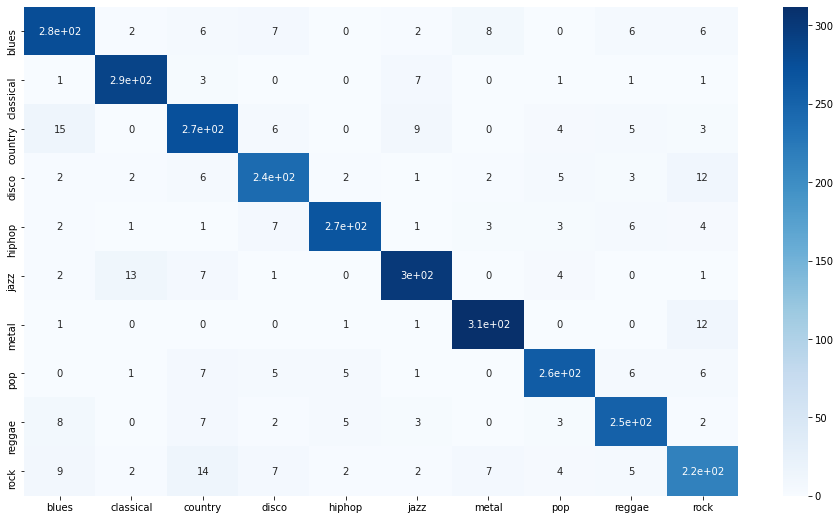

In [41]:
confusion_matr = confusion_matrix(y_test, preds) #normalize = 'true'
plt.figure(figsize = (16, 9))
sns.heatmap(confusion_matr, cmap="Blues", annot=True, 
            xticklabels = ["blues", "classical", "country", "disco", "hiphop", "jazz", "metal", "pop", "reggae", "rock"],
           yticklabels=["blues", "classical", "country", "disco", "hiphop", "jazz", "metal", "pop", "reggae", "rock"]);
plt.savefig("conf matrix")

Some genres, such as rock and metal, have quite many misclassifications, but very different genres, such as hiphop and classicial, have nearly None!

Let's use a convenitent library eli5 (Explain like Im five) to check feature importances

In [43]:
import eli5
from eli5.sklearn import PermutationImportance

perm = PermutationImportance(estimator=xgb, random_state=13)
perm.fit(X_test, y_test)

eli5.show_weights(estimator=perm, feature_names= X_test.columns.tolist())

Weight,Feature
0.1100 ± 0.0041,perceptr_var
0.0477 ± 0.0074,mfcc4_mean
0.0426 ± 0.0056,perceptr_mean
0.0338 ± 0.0052,chroma_stft_mean
0.0336 ± 0.0052,harmony_mean
0.0279 ± 0.0069,harmony_var
0.0235 ± 0.0064,mfcc6_mean
0.0227 ± 0.0036,mfcc9_mean
0.0213 ± 0.0027,rms_var
0.0180 ± 0.0062,tempo



We can even perform recommendation based on features in our dataset. By comparing cosine similarity (direction of the vector of features) we can spot similar songs to the one we like

In [59]:
# Libraries
import IPython.display as ipd
from sklearn.metrics.pairwise import cosine_similarity

data = pd.read_csv(f'{gtzan_path}/features_30_sec.csv', index_col='filename')

# Extract labels
labels = data[['label']]

# Drop lables from original dataframe
data = data.drop(columns=['length', 'label'])
data.head()

# Scale the data
data_scaled = preprocessing.scale(data)
print('Scaled data type: ', type(data_scaled))

Scaled data type:  <class 'numpy.ndarray'>


In [60]:
# Cosine similarity
similarity = cosine_similarity(data_scaled)
print("Similarity shape: ", similarity.shape)

# Convert into a dataframe and then set the row index and column names as labels
sim_df_labels = pd.DataFrame(similarity)
sim_df_names = sim_df_labels.set_index(labels.index)
sim_df_names.columns = labels.index

sim_df_names.head()

Similarity shape:  (1000, 1000)


filename,blues.00000.wav,blues.00001.wav,blues.00002.wav,blues.00003.wav,blues.00004.wav,blues.00005.wav,blues.00006.wav,blues.00007.wav,blues.00008.wav,blues.00009.wav,...,rock.00090.wav,rock.00091.wav,rock.00092.wav,rock.00093.wav,rock.00094.wav,rock.00095.wav,rock.00096.wav,rock.00097.wav,rock.00098.wav,rock.00099.wav
filename,,,,,,,,,,,,,,,,,,,,,
blues.00000.wav,1.000000,0.049231,0.589618,0.284862,0.025561,-0.346688,-0.219483,-0.167626,0.641877,-0.097889,...,-0.082829,0.546169,0.578558,0.662590,0.571629,0.610942,0.640835,0.496294,0.284958,0.304098
blues.00001.wav,0.049231,1.000000,-0.096834,0.520903,0.080749,0.307856,0.318286,0.415258,0.120649,0.404168,...,-0.098111,-0.325126,-0.370792,-0.191698,-0.330834,-0.077301,-0.222119,-0.302573,0.499562,0.311723
blues.00002.wav,0.589618,-0.096834,1.000000,0.210411,0.400266,-0.082019,-0.028061,0.104446,0.468113,-0.132532,...,-0.032408,0.561074,0.590779,0.583293,0.514537,0.495707,0.566837,0.589983,0.216378,0.321069
blues.00003.wav,0.284862,0.520903,0.210411,1.000000,0.126437,0.134796,0.300746,0.324566,0.352758,0.295184,...,-0.320107,-0.206516,-0.151132,0.041986,-0.172515,-0.000287,0.020515,-0.107821,0.502279,0.183210
blues.00004.wav,0.025561,0.080749,0.400266,0.126437,1.000000,0.556066,0.482195,0.623455,0.029703,0.471657,...,0.087605,0.017366,0.138035,0.104684,-0.034594,0.063454,0.063546,0.172944,0.153192,0.061785


In [61]:
def find_similar_songs(name):
    series = sim_df_names[name].sort_values(ascending=False)
    series.drop(name, inplace=True)

    print("\n*****\nSimilar songs to ", name)
    print(series.head(5))

In [62]:
find_similar_songs('pop.00019.wav')

ipd.Audio(opj(genres_dir, 'pop', 'pop.00019.wav'))


*****
Similar songs to  pop.00019.wav
filename
pop.00023.wav    0.862836
pop.00034.wav    0.860499
pop.00078.wav    0.829135
pop.00088.wav    0.824456
pop.00091.wav    0.802269
Name: pop.00019.wav, dtype: float64


In [64]:
find_similar_songs('rock.00019.wav')

ipd.Audio(opj(genres_dir, 'rock', 'rock.00019.wav'))


*****
Similar songs to  rock.00019.wav
filename
rock.00024.wav     0.901913
rock.00017.wav     0.898044
rock.00094.wav     0.888312
rock.00097.wav     0.868376
metal.00060.wav    0.866423
Name: rock.00019.wav, dtype: float64


In [65]:
find_similar_songs('hiphop.00019.wav')

ipd.Audio(opj(genres_dir, 'hiphop', 'hiphop.00019.wav'))


*****
Similar songs to  hiphop.00019.wav
filename
hiphop.00024.wav    0.738700
hiphop.00009.wav    0.714162
pop.00085.wav       0.658778
hiphop.00038.wav    0.619719
blues.00075.wav     0.600040
Name: hiphop.00019.wav, dtype: float64
